In [1]:
import sys
sys.path.append('..')

import tomodpdt

import numpy as np
import matplotlib.pyplot as plt

import time
import deeplay as dl

import torch
import torch.nn as nn
from torch.utils.data import DataLoader

c:\Users\fredr\AppData\Local\GitHubDesktop\app-3.4.12\TomoDpDt\Notebooks\..\deeptrack_t\__init__.py:14: UserWarning: TensorFlow is detected in your environment. DeepTrack2 version 2.0++ no longer supports TensorFlow. If you need TensorFlow support, please install the legacy version 1.7 of DeepTrack2:

    pip install deeptrack==1.7

For more details, refer to the DeepTrack documentation.
  warnings.warn(


In [2]:
volume = tomodpdt.VOL_GAUSS_MULT

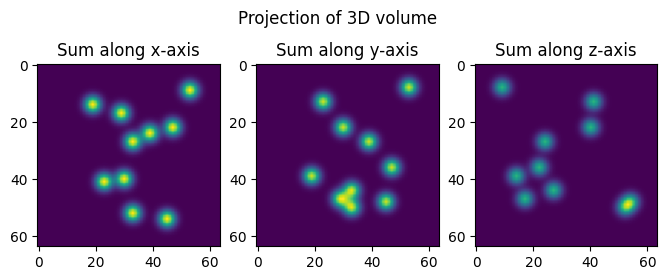

In [3]:
fig, ax = plt.subplots(1, 3, figsize=(8, 3))
plt.suptitle("Projection of 3D volume")
ax[0].set_title("Sum along x-axis")
ax[0].imshow(volume.sum(0))
ax[1].set_title("Sum along y-axis")
ax[1].imshow(volume.sum(1))
ax[2].set_title("Sum along z-axis")
ax[2].imshow(volume.sum(2))
plt.show()

In [4]:
from tomodpdt.imaging_modality_torch import SumAvgWeighted3d2d, Sum3d2d

sumawg = SumAvgWeighted3d2d(dim=-1)

In [5]:
test_object, q_gt, projections, imaging_model = tomodpdt.simulate.create_data(
    volume=volume,
    image_modality=sumawg,
    rotation_case='sinusoidal'
    )

Simulating... 25.0%
Simulating... 50.0%
Simulating... 75.0%


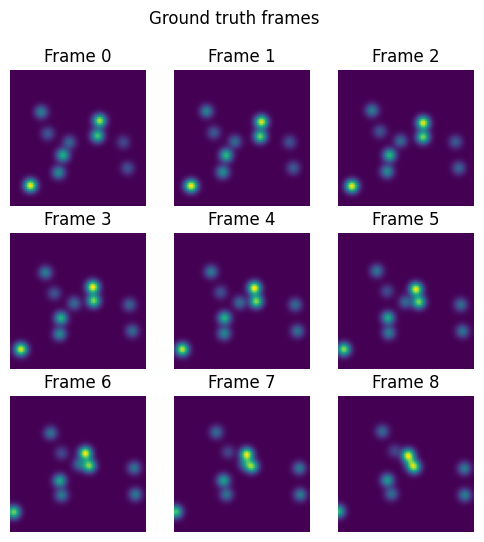

In [6]:
fig, ax = plt.subplots(3, 3, figsize=(6, 6))
plt.suptitle("Ground truth frames")
for i in range(3):
    for j in range(3):
        ax[i, j].imshow(projections[i * 3 + j, 0])
        ax[i, j].set_title(f'Frame {i * 3 + j}')
        ax[i, j].axis('off')

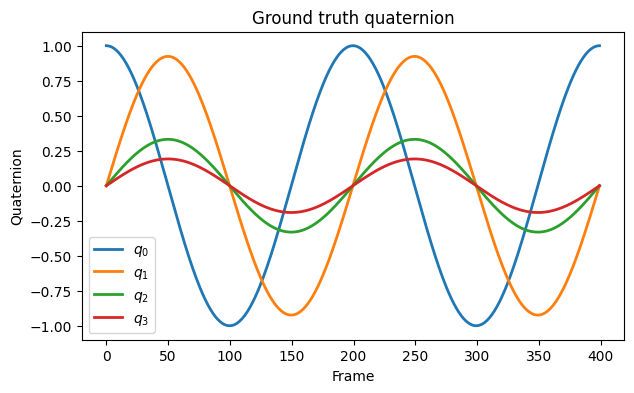

In [7]:
plt.figure(figsize=(7, 4))
plt.plot(q_gt[:, 0].cpu(), label=r'$q_0$', linewidth=2)
plt.plot(q_gt[:, 1].cpu(), label=r'$q_1$', linewidth=2)
plt.plot(q_gt[:, 2].cpu(), label=r'$q_2$', linewidth=2)
plt.plot(q_gt[:, 3].cpu(), label=r'$q_3$', linewidth=2)
plt.legend()
plt.xlabel('Frame')
plt.ylabel('Quaternion')
plt.title('Ground truth quaternion')
plt.show()

In [8]:
N=64
# Create the tomography model
tomo = tomodpdt.Tomography(
    volume_size=(N, N, N),
    rotation_optim_case='basis',
    initial_volume='refraction',
    imaging_model=sumawg, 
    )


In [9]:
# Initialize the parameters
tomo.initialize_parameters(projections, normalize=True)

c:\Users\fredr\miniconda3\envs\torchenv\Lib\site-packages\lightning\pytorch\trainer\configuration_validator.py:74: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.

  | Name                | Type                 | Params
-------------------------------------------------------------
0 | encoder             | Sequential           | 79.5 K
1 | fc_mu               | MultiLayerPerceptron | 32.8 K
2 | fc_var              | MultiLayerPerceptron | 32.8 K
3 | fc_dec              | MultiLayerPerceptron | 51.3 K
4 | decoder             | Sequential           | 61.0 K
5 | reconstruction_loss | BCELoss              | 0     
6 | train_metrics       | MetricCollection     | 0     
7 | val_metrics         | MetricCollection     | 0     
8 | test_metrics        | MetricCollection     | 0     
9 | optimizer           | Adam                 | 0     
-------------------------------------------------------------
257 K     Trainable params
0         Non-trainable params
257 K

Epoch 0:  38%|███▊      | 5/13 [00:01<00:01,  4.39it/s, v_num=20, train_rec_loss_step=1.1e+5, train_KL_step=98.40, train_total_loss_step=1.1e+5]  

c:\Users\fredr\miniconda3\envs\torchenv\Lib\site-packages\torch\autograd\graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\cudnn\Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


Epoch 249: 100%|██████████| 13/13 [00:00<00:00, 50.26it/s, v_num=20, train_rec_loss_step=4.63e+3, train_KL_step=244.0, train_total_loss_step=4.63e+3, train_rec_loss_epoch=9.18e+3, train_KL_epoch=437.0, train_total_loss_epoch=9.19e+3]  


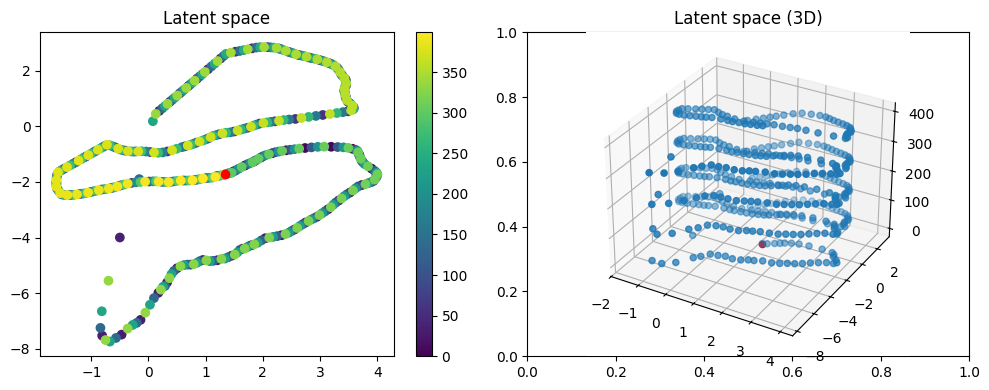

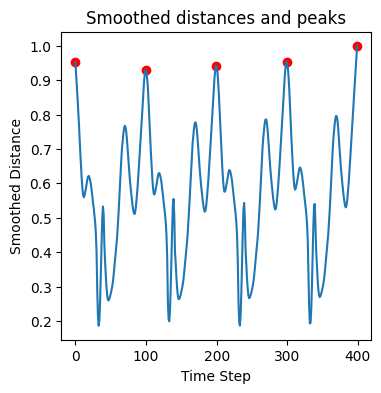

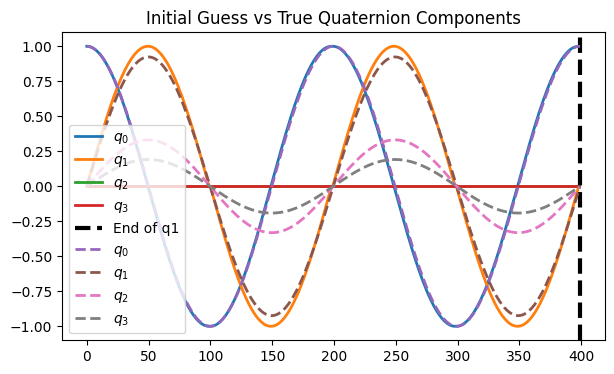

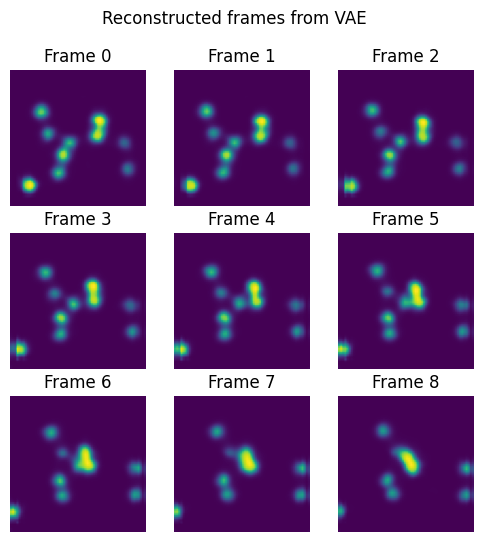

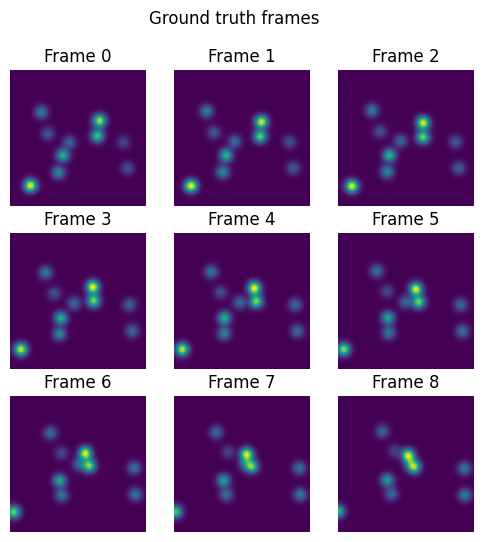

In [10]:
tomodpdt.plotting.plots_initial(tomo, gt=q_gt.to('cpu'))

In [ ]:
# Train the model
N = len(tomo.frames)
idx = torch.arange(N)

start_time = time.time()

# Toggle the gradients rotation params to off for initial phase
tomo.toggle_gradients_quaternion(False)

# First axis test.
trainer = dl.Trainer(max_epochs=10, accelerator="auto", log_every_n_steps=10)
trainer.fit(tomo, DataLoader(idx, batch_size=64, shuffle=True))
loss1 = trainer.callback_metrics['train_total_loss_epoch'].item()
vol1 = tomo.volume.clone()
rot1 = tomo.rotation_params.clone()    

# Swap the rotation axis.
tomo.swap_rotation_axis()
tomo.initialize_volume()
tomo.move_all_to_device("cuda")
trainer = dl.Trainer(max_epochs=10, accelerator="auto", log_every_n_steps=10)
trainer.fit(tomo, DataLoader(idx, batch_size=64, shuffle=True))
loss2 = trainer.callback_metrics['train_total_loss_epoch'].item()
vol2 = tomo.volume.clone()
rot2 = tomo.rotation_params.clone()

# Choose the best loss and proceed with that.
if loss1 < loss2:
    print("Loss 1 is better ie. choose optimized axis", loss1, loss2)
    tomo.volume = nn.Parameter(vol1)
    tomo.rotation_params = nn.Parameter(rot1)
else:
    del vol1, rot1, loss1, vol2, rot2, loss2

c:\Users\fredr\miniconda3\envs\torchenv\Lib\site-packages\lightning\pytorch\trainer\configuration_validator.py:74: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.

  | Name          | Type                   | Params
---------------------------------------------------------
0 | vae_model     | VariationalAutoEncoder | 257 K 
1 | encoder       | Sequential             | 79.5 K
2 | fc_mu         | MultiLayerPerceptron   | 32.8 K
3 | imaging_model | SumAvgWeighted3d2d     | 0     
4 | train_metrics | MetricCollection       | 0     
5 | val_metrics   | MetricCollection       | 0     
6 | test_metrics  | MetricCollection       | 0     
7 | optimizer     | Adam                   | 0     
  | other params  | n/a                    | 149 K 
---------------------------------------------------------
262 K     Trainable params
257 K     Non-trainable params
519 K     Total params
2.079     Total estimated model params size (MB)
c:\Users\fredr\miniconda3\envs\torche

Epoch 9: 100%|██████████| 7/7 [00:00<00:00, 19.67it/s, v_num=21, train_proj_loss_step=0.236, train_latent_loss_step=0.401, train_rtv_loss_step=0.00101, train_qv_loss_step=0.000453, train_q0_loss_step=0.000, train_rtr_loss_step=0.000, train_so_loss_step=0.000402, train_total_loss_step=0.639, train_proj_loss_epoch=0.243, train_latent_loss_epoch=0.311, train_rtv_loss_epoch=0.000999, train_qv_loss_epoch=0.000388, train_q0_loss_epoch=0.00803, train_rtr_loss_epoch=0.000, train_so_loss_epoch=0.000401, train_total_loss_epoch=0.564]  



  | Name          | Type                   | Params
---------------------------------------------------------
0 | vae_model     | VariationalAutoEncoder | 257 K 
1 | encoder       | Sequential             | 79.5 K
2 | fc_mu         | MultiLayerPerceptron   | 32.8 K
3 | imaging_model | SumAvgWeighted3d2d     | 0     
4 | train_metrics | MetricCollection       | 0     
5 | val_metrics   | MetricCollection       | 0     
6 | test_metrics  | MetricCollection       | 0     
7 | optimizer     | Adam                   | 0     
  | other params  | n/a                    | 149 K 
---------------------------------------------------------
262 K     Trainable params
257 K     Non-trainable params
519 K     Total params
2.079     Total estimated model params size (MB)


Epoch 9: 100%|██████████| 7/7 [00:00<00:00, 22.25it/s, v_num=22, train_proj_loss_step=0.286, train_latent_loss_step=0.668, train_rtv_loss_step=0.000883, train_qv_loss_step=0.000377, train_q0_loss_step=0.000, train_rtr_loss_step=0.000, train_so_loss_step=0.00035, train_total_loss_step=0.956, train_proj_loss_epoch=0.292, train_latent_loss_epoch=0.694, train_rtv_loss_epoch=0.000868, train_qv_loss_epoch=0.000388, train_q0_loss_epoch=0.00803, train_rtr_loss_epoch=0.000, train_so_loss_epoch=0.000342, train_total_loss_epoch=0.995]  
Loss 1 is better ie. choose optimized axis 0.5637408494949341 0.9949067831039429


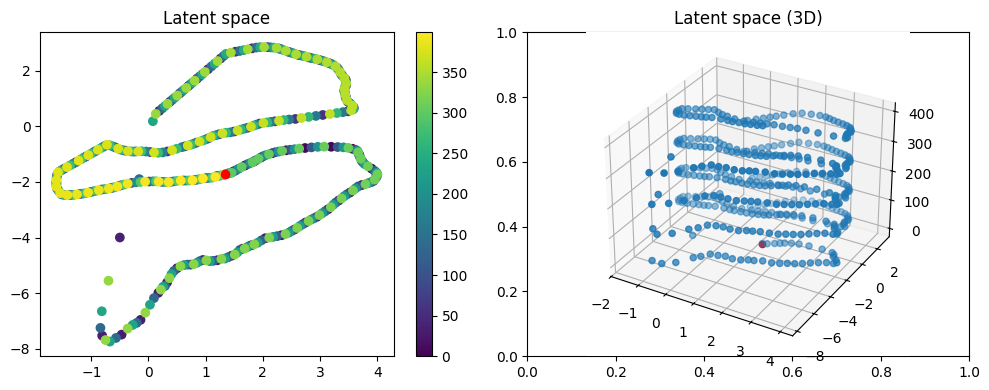

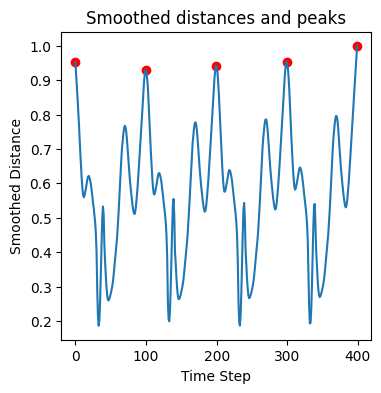

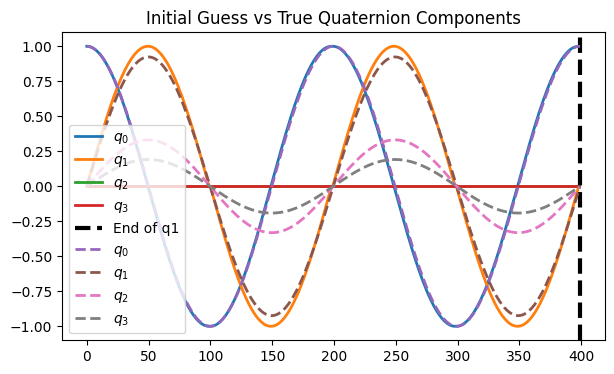

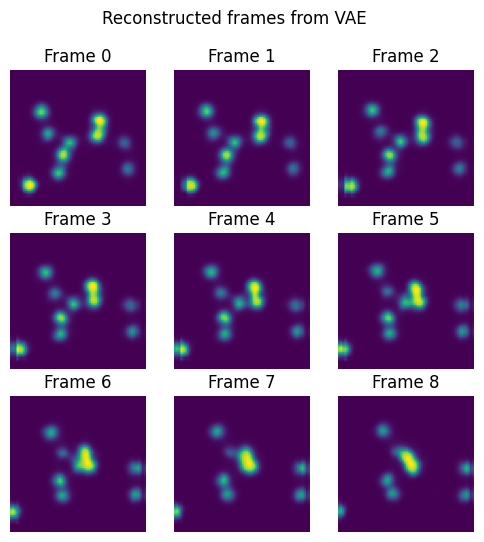

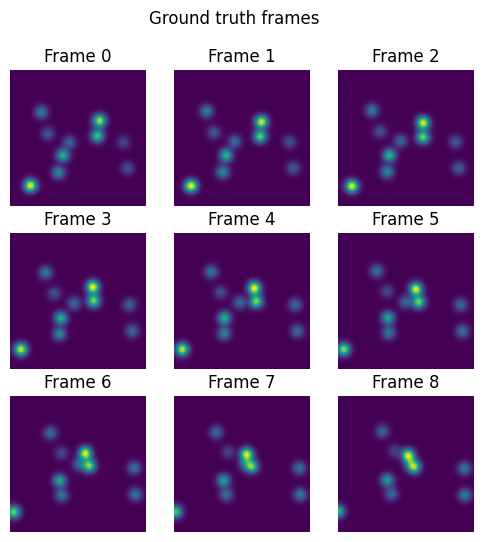


  | Name          | Type                   | Params
---------------------------------------------------------
0 | vae_model     | VariationalAutoEncoder | 257 K 
1 | encoder       | Sequential             | 79.5 K
2 | fc_mu         | MultiLayerPerceptron   | 32.8 K
3 | imaging_model | SumAvgWeighted3d2d     | 0     
4 | train_metrics | MetricCollection       | 0     
5 | val_metrics   | MetricCollection       | 0     
6 | test_metrics  | MetricCollection       | 0     
7 | optimizer     | Adam                   | 0     
  | other params  | n/a                    | 149 K 
---------------------------------------------------------
262 K     Trainable params
257 K     Non-trainable params
519 K     Total params
2.079     Total estimated model params size (MB)
c:\Users\fredr\miniconda3\envs\torchenv\Lib\site-packages\lightning\pytorch\loops\fit_loop.py:298: The number of training batches (4) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every

Epoch 99: 100%|██████████| 4/4 [00:00<00:00,  4.48it/s, v_num=23, train_proj_loss_step=0.175, train_latent_loss_step=0.0683, train_rtv_loss_step=0.00161, train_qv_loss_step=6.89e-5, train_q0_loss_step=0.000, train_rtr_loss_step=0.000804, train_so_loss_step=0.000677, train_total_loss_step=0.246, train_proj_loss_epoch=0.286, train_latent_loss_epoch=0.482, train_rtv_loss_epoch=0.0016, train_qv_loss_epoch=0.000376, train_q0_loss_epoch=5.87e-5, train_rtr_loss_epoch=0.000984, train_so_loss_epoch=0.000669, train_total_loss_epoch=0.772]     
Training time:  1.6054732521375021  minutes
No history to plot...


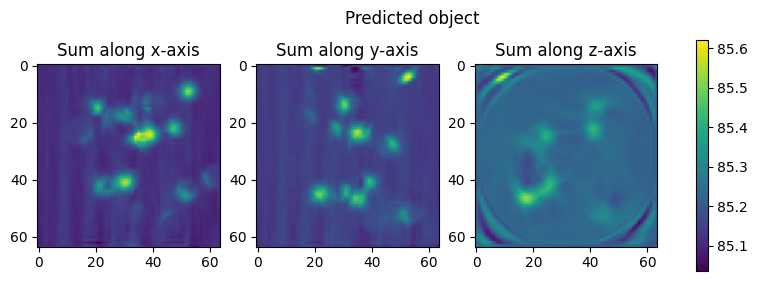

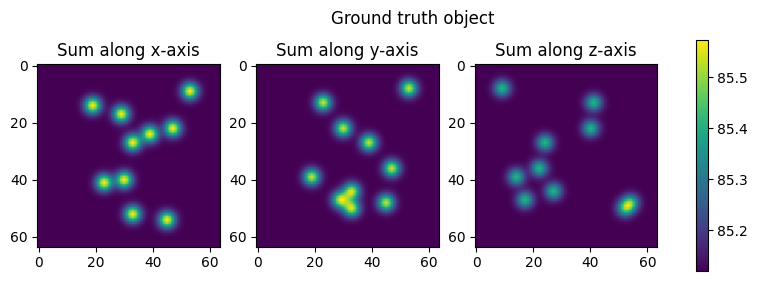

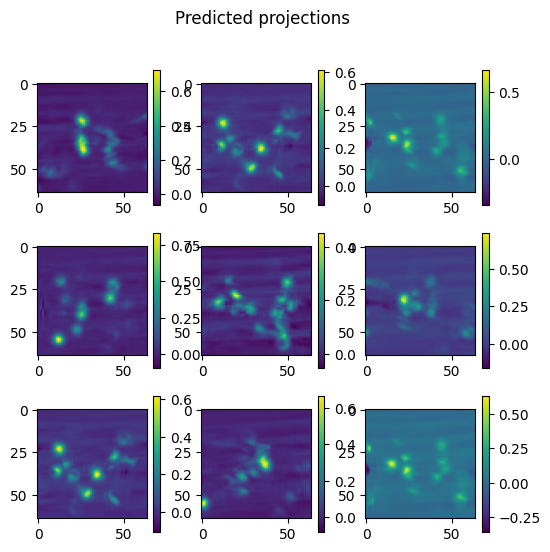

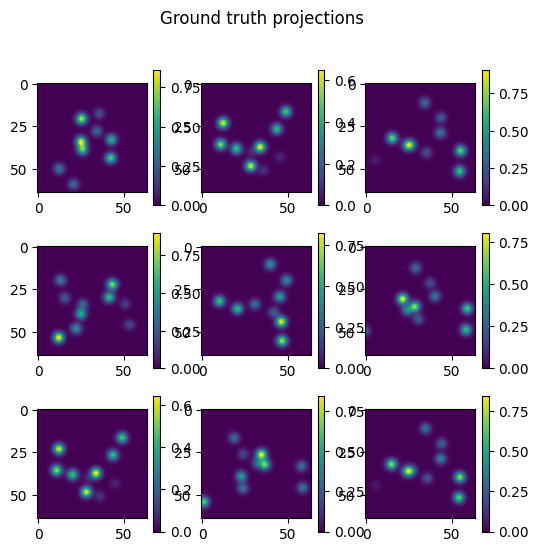

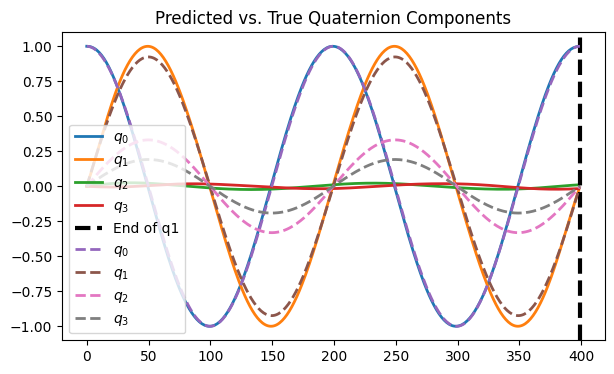

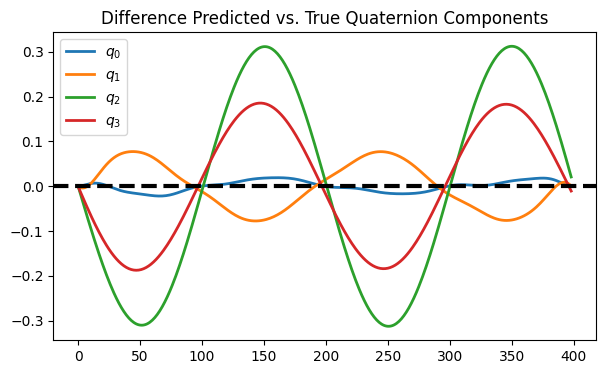

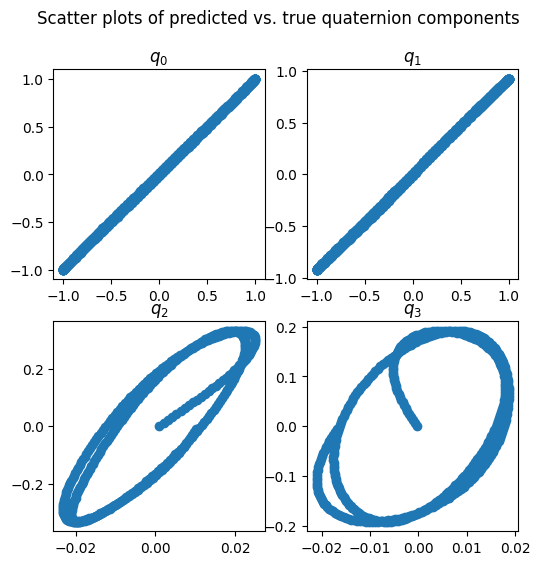

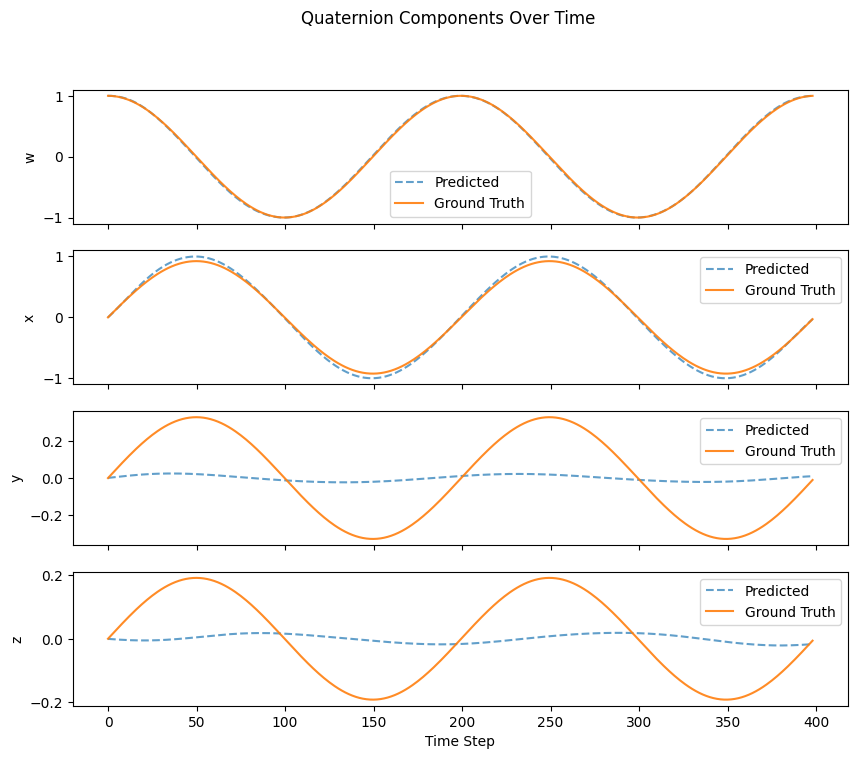

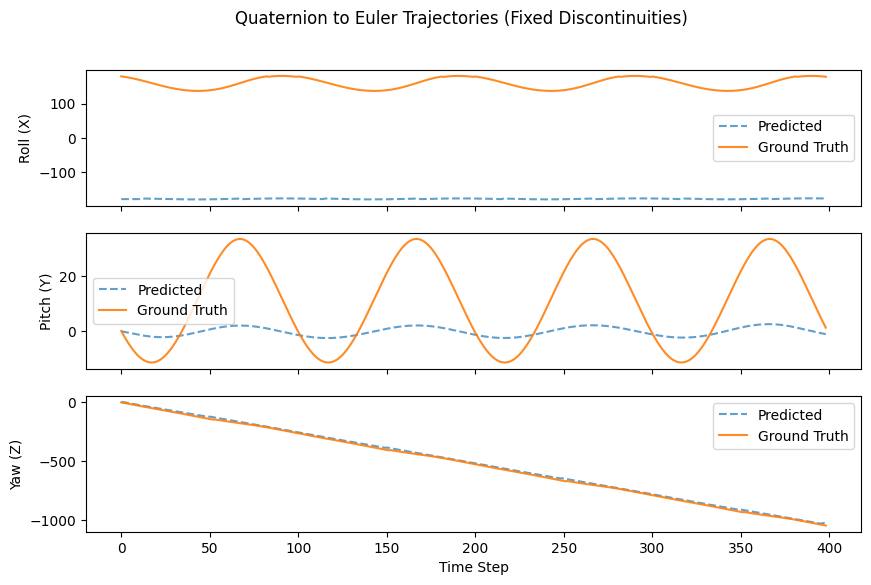

In [ ]:
#Toggle the gradients of the quaternion parameters
tomo.toggle_gradients_quaternion(True)
tomo.move_all_to_device("cuda")
trainer = dl.Trainer(max_epochs=500, accelerator="auto", log_every_n_steps=10)
trainer.fit(tomo, DataLoader(idx, batch_size=128, shuffle=False))
tomo.move_all_to_device("cuda")
print("Training time: ", (time.time() - start_time) / 60, " minutes")

# Plot the training history
try:
    trainer.history.plot()
except:
    print("No history to plot...")

# Visualize the final volume and rotations.
tomodpdt.plotting.plots_optim(tomo, gt_q=q_gt.to('cpu'), gt_v=test_object.to('cpu'))